# Distortion Measurements noise analysis

This notebook is focused at analysing the noise and outliers that contaminate the data collected for the purpose of analysing and solving the distortion issue. 

## Load Data and prepare setup:

In [9]:
# automaticlly updates imported methods when they change
%load_ext autoreload
%autoreload 2

from tools import calcRxPower, load_npy_into_dict, plot_gl_as_func_temp, get_panchromatic_meas, \
        plot_regression_p_vs_p, plot_regression_diff
import matplotlib.pyplot as plt
import matplotlib
import numpy as np
from multiprocessing import Pool, cpu_count
from scipy.optimize import nnls
from itertools import product
from tqdm import tqdm
from pathlib import Path
matplotlib.rcParams.update({'font.size': 14})

path_to_files = Path("rawData")
meas_panchromatic, list_power_panchormatic, list_blackbody_temperatures = get_panchromatic_meas(path_to_files)


Load measurements: 100%|██████████| 11/11 [01:21<00:00,  7.36s/it]


## Preliminary Inspection
To have some grasp regarding the way the data looks, let's first show the images of the data we have in hand.
To reduce noise effects, we will only show average of the frames taken at each temperature over the 2000 acquired frames 


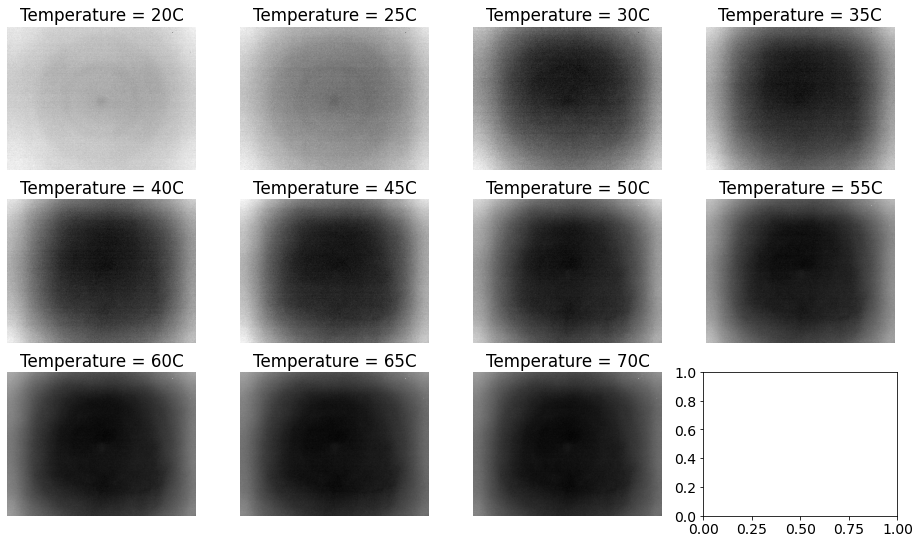

In [12]:
import plotly.express as px
def showFacetImages(img_arr, label_class, labels, facet_col=0):
    fig = px.imshow(img_arr, facet_col=facet_col, facet_col_wrap=4, color_continuous_scale='gray')
    # Set facet titles
    for i in range(len(list_blackbody_temperatures)):
        temp_idx = int(fig.layout.annotations[i]['text'].split("=")[-1])
        fig.layout.annotations[i]['text'] = f'{label_class} = {labels[temp_idx]}'
    fig.show()

meas_panchromatic_mean = meas_panchromatic.mean(axis=1)
fig, ax = plt.subplots(3,4, figsize=(16, 9))
for i, image in enumerate(meas_panchromatic_mean):
    ax[i//4, i%4].imshow(image, cmap="gray")
    ax[i//4, i%4].set_title(f"Temperature = {list_blackbody_temperatures[i]}C")
    ax[i//4, i%4].axis("off")

# fig = px.imshow(meas_panchromatic_mean[0],
#                 color_continuous_scale='gray')
# fig.show()


While not easily observable, some pixels in the upper-right corner are "burned", resulting in a salt-and-pepper like noise.
This is more clear when plotting a single temperature image:

In [80]:
fig = px.imshow(meas_panchromatic_mean[0], color_continuous_scale='gray', title="Single Temperature Image (With Burned Pixels)")
fig.show()


To eliminate the effect of these pixels, a simple $2 \times 2$ median  filter would be sufficiently large to eliminate them, and sufficiently small to avoid distorting the original values too much.

In [32]:
from scipy.ndimage import median_filter, gaussian_filter
meas_panchromatic_prefilt = median_filter(meas_panchromatic, size=(1,1,2,2))



Lets verify that the median filtering did remove the burned pixels:

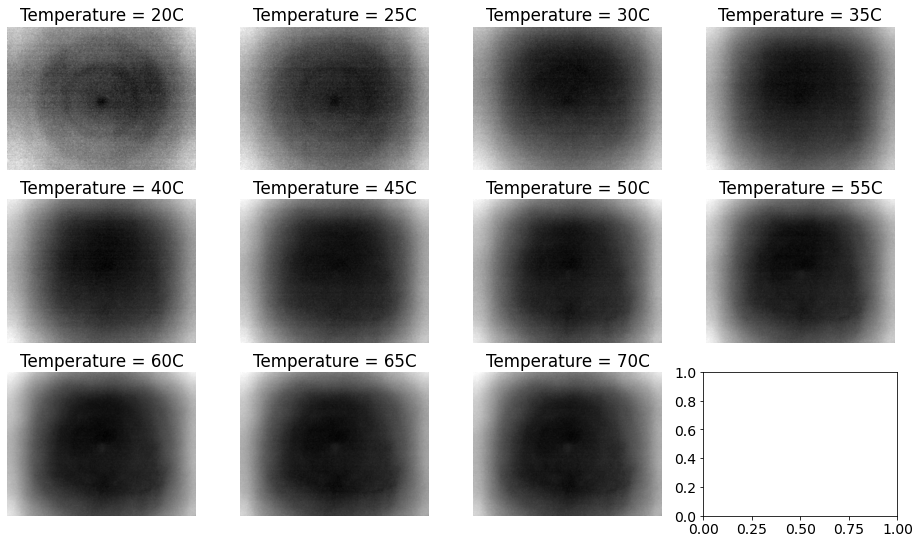

In [40]:
meas_panchromatic_mean = meas_panchromatic_prefilt.mean(axis=1)
fig, ax = plt.subplots(3, 4, figsize=(16, 9))
for i, image in enumerate(meas_panchromatic_mean):
    ax[i//4, i % 4].imshow(image, cmap="gray")
    ax[i//4, i %
        4].set_title(f"Temperature = {list_blackbody_temperatures[i]}C")
    ax[i//4, i % 4].axis("off")


Indeed, it seems like the burned pixels no longer appear in the images.

## Analyse the noise level of a a random pixel across the 2000 frames taken per temperature

,20,25,30,35,40,45,50,55,60,65,70
0,3276,3149,3371,3298,3351,3423,5010,3529,3336,3534,6796
1,3276,3149,3313,3757,4217,4624,5010,3532,3336,3533,6796
2,3278,3154,3313,3756,4217,4627,5010,3532,5736,3533,6796
3,2796,3154,3313,3756,4217,4628,5008,5457,5736,6327,6795
4,2796,3153,3313,3756,4217,4628,5008,5457,5736,6327,6795


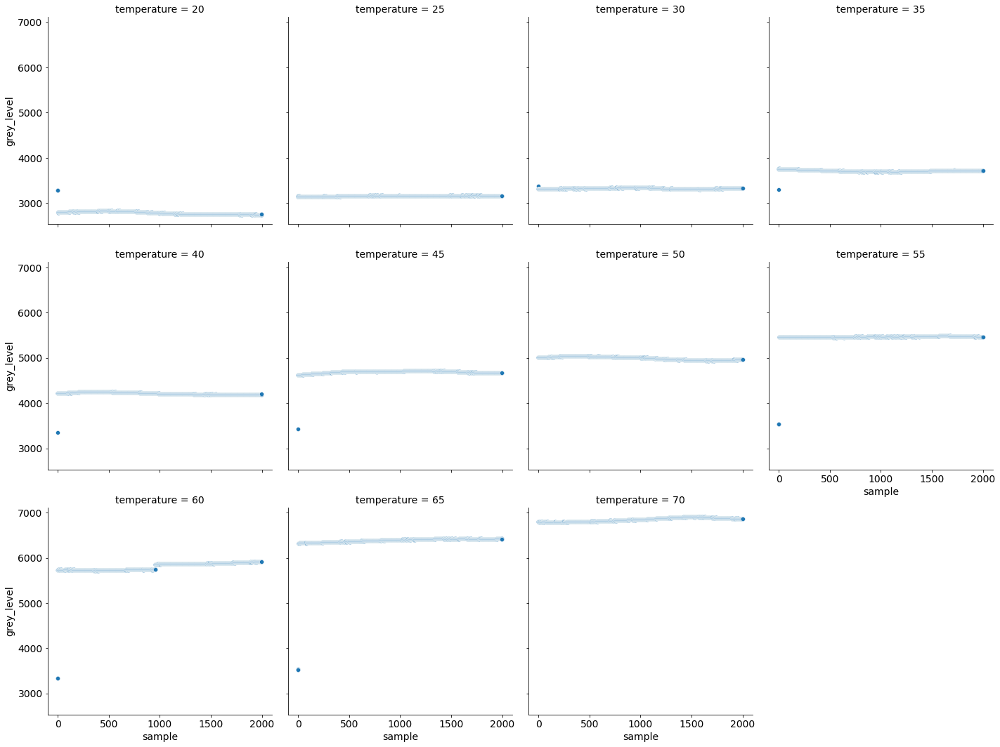

In [48]:
# get the random pixel across frames and temperature
import pandas as pd
import seaborn as sns


def plotNoiseAnalysis(data):
    pix_over_frames_disp = data.melt(
        var_name="temperature", value_name="grey_level", ignore_index=False)
    pix_over_frames_disp.index.rename("sample", inplace=True)
    pix_over_frames_disp.reset_index(level=0, inplace=True)
    sns.relplot(x="sample", y="grey_level", data=pix_over_frames_disp,
                col="temperature", col_wrap=4)


pix_idx = np.random.randint(
    low=[0, 0], high=meas_panchromatic_prefilt.shape[2:], size=2)
pix_over_frames = pd.DataFrame(
    meas_panchromatic_prefilt[..., pix_idx[0], pix_idx[1]].T, columns=list_blackbody_temperatures)
plotNoiseAnalysis(pix_over_frames)
pix_over_frames.head()


Seems like there are a few interesting things that require attention:
1. The first frame of each temperature appears to be an outlier. infact, after some more careful verification, it seems that in some cases, all first 3 frames exhibit this phenomenon. To be on the safe side, it would be a good idea to discard them for the purpose of any further analysis.
2. There's a discontinuity in the acquisition of the 60 degrees results - perhaps these measurements should also be discarded for the purpose of the analysis.
3. The noise is highly correlated, as the trends in noise are smooth. This means that a gaussian noise assumption isn't valid. Nontheless, as trends are inconsistent at different temperatures (some are positive, some negative, and some oscillate and return to the same level) and since the trends' magnitudes aren't very significant, averaging frames might still be the best idea to eliminate the noise. 

,20,25,30,35,40,45,50,55,65,70
3,2796,3154,3313,3756,4217,4628,5008,5457,6327,6795
4,2796,3153,3313,3756,4217,4628,5008,5457,6327,6795
5,2796,3152,3313,3757,4217,4628,5008,5457,6327,6795
6,2794,3152,3313,3757,4217,4627,5006,5457,6327,6795
7,2794,3151,3313,3757,4217,4627,5006,5456,6328,6795


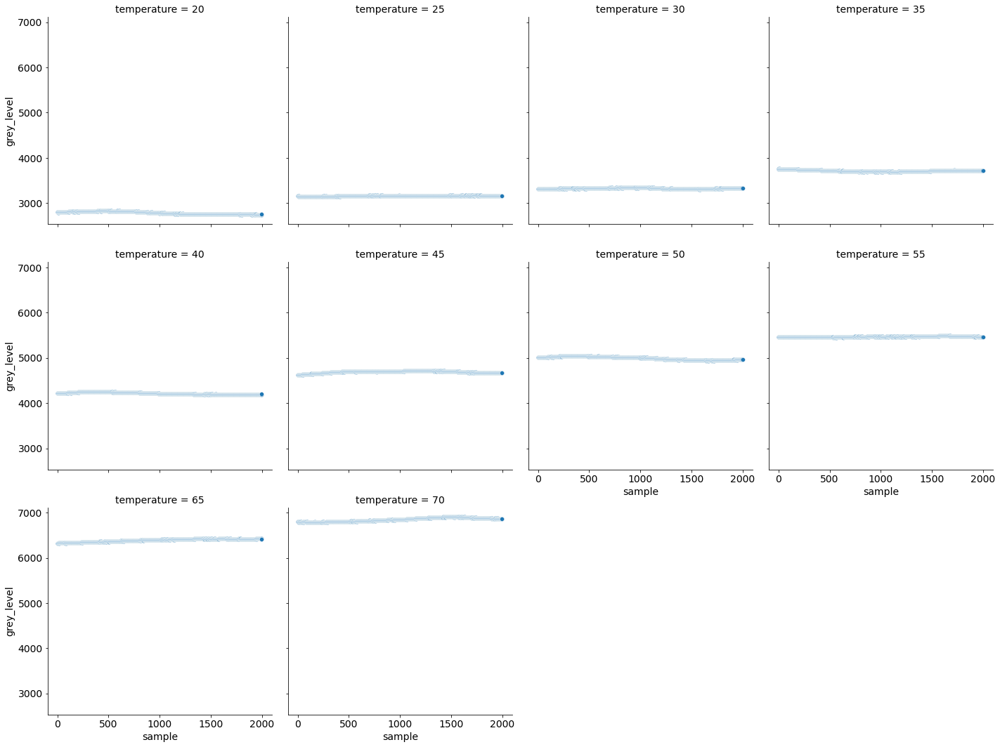

In [52]:
# remove the first 3 samples as well as the 60C measurements from the data, and repeat analysis:
pix_over_frames_postprocess = pix_over_frames.copy()
pix_over_frames_postprocess.drop(columns=60, inplace=True)
pix_over_frames_postprocess.drop(index=[0, 1, 2], axis=0, inplace=True)
plotNoiseAnalysis(pix_over_frames_postprocess)
pix_over_frames_postprocess.head()

Now, the data looks much cleaner and ready for the noise analysis.

## Estimate the residual per-pixel noise level afetr averaging
We will now apply the data cleaning procedure over all the samples and get a per-pixel std estimate for all temperatures:

In [73]:
## calculate the per-pixel std map
meas_panchromatic_clean = meas_panchromatic_prefilt[:, 3:, ...].copy()  # drop three first samples
meas_panchromatic_clean = np.delete(
    meas_panchromatic_clean, list_blackbody_temperatures.index(60), 0)  # remove the 60 degrees measurements

list_blackbody_temperatures.remove(60)
std_map = meas_panchromatic_clean.std(axis=1)


In [86]:
## plot the std map
import plotly.express as px
fig = px.imshow(std_map, facet_col=0, facet_col_wrap=4, labels={"facet_col": "temperature"}, color_continuous_scale='gray')

# Set facet titles
for i in range(len(list_blackbody_temperatures)):
    temp_idx = int(fig.layout.annotations[i]['text'].split("=")[-1])
    fig.layout.annotations[i]['text'] = f'temperature = {list_blackbody_temperatures[temp_idx]}'
fig.show()


As apparent, the noise level is temperature dependent (not monotonic), with the worst obtained at 70C, having an std of ~45 grey-levels in the worst case.

Hence, averaging over 2000 samples is expected to reduce the noise std to $\frac{45}{\sqrt(2000)} \approx 1$ grey-levels in the worst case, which is very good for our purposes.

A vertical stripes pattern in the noise maps indicates some sort of a horizontal oscilatory phenomenon, but it appears to have a negligible magnitude ($\propto 1$ grey-level) 

## SNR
Our goal is to be able to estimate the temperature upto an accuracy level of 1C. To that end, we want to make sure that the measuremts that we rely on for calibrating and processing our camera have a high-enough SNR.

In order to have a measure of that quantity, we can:
1. Use a linear regression to model the grey-level variations vs the black-body's temperature.
2. Figure out what's the noise std level is in terms of temperature (C), and relate it to the regressions' slopes. 



### Pixel-wise linear regressions
We will apply a pixel-wise linear regression model, to obtain a $2\times m \times n$ feature maps with the slope and free coefficients

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

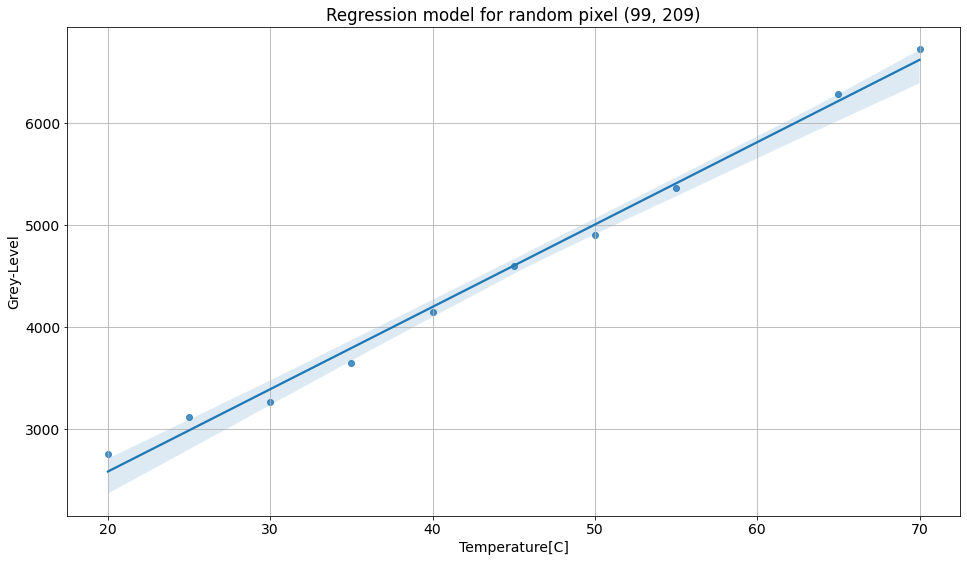

In [97]:
# first, let's display a regression model for an arbitrary pixel:
from sklearn.linear_model import LinearRegression
from IPython.display import display, Latex

i, j = np.random.randint((0, 0), meas_panchromatic_clean.shape[2:])
regress_target_eg = meas_panchromatic_clean[..., i, j].mean(axis=1)
x, y = np.array(list_blackbody_temperatures)[:, np.newaxis], regress_target_eg[:, np.newaxis]
lr = LinearRegression().fit(x,y)
plt.figure(figsize=(16, 9))
res = sns.regplot(x=x, y=y, fit_reg=True)
plt.title(f"Regression model for random pixel {(i, j)}")
plt.xlabel("Temperature[C]")
plt.ylabel("Grey-Level")
plt.grid()

display(Latex(fr"Regression result: $GL = {lr.coef_.squeeze():.3f} \times T +{lr.intercept_.squeeze():.3f}$"))
display(Latex(fr"$R^2 = {lr.score(x, y):.3f}$"))


According to the regression results:
1. The linear model is a good fit ($R^2>0.99$)
2. The slope ($\approx 80 [\frac{GL}{C}]$) is a lot greater than the averaged samples noise std ($\approx 1 [\frac{GL}{C}]$), and is even greater than the worst-case single-sample noise ($\approx 45 [\frac{GL}{C}]$).

Now, let's verify these stats by performing the regression over the entire spatial domain:


In [103]:

# Compute the regression:
meas_shape = meas_panchromatic_clean.shape
meas_regress = meas_panchromatic_clean.mean(axis=1).reshape(meas_shape[0], -1)  # Reshape data to fit a regression model
lr_all = LinearRegression().fit(x, meas_regress)
slopes_map = lr_all.coef_.reshape(meas_shape[2], -1)
intercept_map = lr_all.intercept_.reshape(meas_shape[2], -1)

# plot slopes:
fig = px.imshow(slopes_map, color_continuous_scale='gray', title="Linear Regression Slopes Map")
fig.show()

fig = px.imshow(intercept_map, color_continuous_scale='gray', title="Linear Regression Intercepts Map")
fig.show()



As seen from the results, the regressed slopes map has some sort of gaussian 2d-like pattern, ranging from $\approx 80 [\frac{GL}{C}]$ in the middle, to $\approx 85 [\frac{GL}{C}]$ at the edges.

## Invert grey-levels using regression model
Using the coefficients of the learned regression model, we can calculate the inverse-model and get an estimated temperature based on the input gray level:



In [273]:
gl2T = lambda gl, slope, intercept: (gl-intercept) / slope

operating_point = 45  #[C]
op_image = meas_panchromatic_prefilt.mean(axis=1)[list_blackbody_temperatures.index(operating_point), ...]
t_hat = gl2T(op_image, slopes_map, intercept_map)

fig = px.imshow(t_hat, color_continuous_scale='gray')
fig.show()


## Validation
In order to test the goodness of the regression, a good way would be to look at the estimated temperatures based on the inverse of the regression model:
$$ \hat{GL} = slope \times T + intercept \Rightarrow \hat{T} = \frac{GL - intercept}{slope} $$ 

As all images are of a black-body with a spatially-uniform and fixed temperature, we desire the the inverse regression model to produce images with intensity levels coresponding to the black-body's temperature, with as little variance as possible.
 

In [539]:
meas_panchromatic_df = pd.DataFrame(meas_regress.T, columns=list_blackbody_temperatures)
t_hat_df = gl2T(meas_panchromatic_df, slopes_map.reshape(-1, 1), intercept_map.reshape(-1,1))
est_err = np.array(list_blackbody_temperatures) - t_hat_df
print("RMSE:\n")
print(np.sqrt((est_err**2).mean()))
print("\n")
print("Estimation Statistics:\n")
t_hat_df.describe()


RMSE:

20    2.047136
25    1.574854
30    1.539236
35    1.825721
40    0.634505
45    0.039497
50    1.258962
55    0.551385
65    0.826829
70    1.337320
dtype: float64


Estimation Statistics:



,20,25,30,35,40,45,50,55,65,70
count,86016.000000,86016.000000,86016.000000,86016.000000,86016.000000,86016.000000,86016.000000,86016.000000,86016.000000,86016.000000
mean,22.045997,26.574148,28.461598,33.175150,39.367294,45.020979,48.741500,54.451349,65.825153,71.336831
std,0.068285,0.047142,0.050684,0.056388,0.047748,0.033465,0.034107,0.054838,0.052617,0.036153
min,21.768643,26.385228,28.305141,33.023352,39.226409,44.880625,48.606458,54.269778,65.627947,71.180621
25%,22.000692,26.542334,28.422934,33.134798,39.331518,44.998190,48.717963,54.409312,65.790160,71.314672
50%,22.049733,26.575886,28.459069,33.166286,39.359565,45.021266,48.740748,54.455848,65.825884,71.337083
75%,22.096719,26.609764,28.498766,33.207007,39.399231,45.043953,48.763955,54.492589,65.863387,71.360973
max,22.224542,26.723632,28.633701,33.445896,39.548387,45.173255,48.876355,54.622957,65.990386,71.452035


A few observations can be made based on the obtained statistics:
1. The linear model isn't a very good estimate for many operating points, with an RMSE of >2C in the worst case, and >1C for more than half the operating points.
2. The standard-deviation of all operating points is incredibely small, suggesting that the error trend is very similar for all pixels

These observations give hope that a better model (perhaps a higher degree polynomial) will result in a better fit for all pixels.

Regardless of the suggested models, a proper evaluation should be based on a validation set of measurements that weren't used for constructing the model.